In [ ]:


import cv2 as cv
import matplotlib.pyplot as plt
from google.colab import drive
from google.colab.patches import cv2_imshow
import numpy as np



In [ ]:


drive.mount("/content/drive")



Mounted at /content/drive


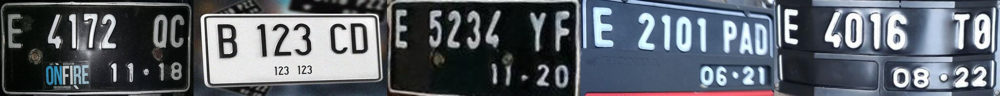

In [3]:


img1 = cv.resize(cv.imread("/content/drive/MyDrive/UTS/dummy/1.jpg"), (600, 300))
img2 = cv.resize(cv.imread("/content/drive/MyDrive/UTS/dummy/2.jpg"), (600, 300))
img3 = cv.resize(cv.imread("/content/drive/MyDrive/UTS/dummy/3.jpg"), (600, 300))
img4 = cv.resize(cv.imread("/content/drive/MyDrive/UTS/dummy/4.jpg"), (600, 300))
img5 = cv.resize(cv.imread("/content/drive/MyDrive/UTS/dummy/5.jpg"), (700, 300))

final_frame = np.hstack((img1, img2, img3, img4, img5))

cv2_imshow(final_frame)



Resolusi

In [5]:
def resolution(img, skala):
  result = cv.resize(img, None, fx=skala, fy=skala, interpolation=cv.INTER_CUBIC)
  return result

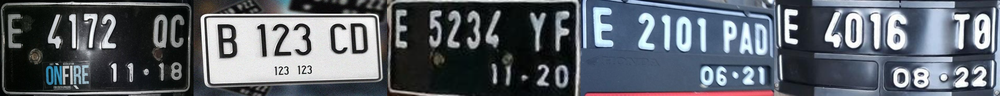

In [7]:
resolution_img1 = resolution(img1, 2)
resolution_img2 = resolution(img2, 2)
resolution_img3 = resolution(img3, 2)
resolution_img4 = resolution(img4, 2)
resolution_img5 = resolution(img5, 2)

final_frame = np.hstack((resolution_img1, resolution_img2, resolution_img3, resolution_img4, resolution_img5))
cv2_imshow(final_frame)

Brightness

In [8]:
def brightness(img, n):
  brightness_image = np.zeros(img.shape, img.dtype)

  for y in range(img.shape[0]):
    for x in range(img.shape[1]):
      for c in range(img.shape[2]):
        brightness_image[y, x, c] = np.clip(img[y,x,c] + n, 0, 255)
  return brightness_image

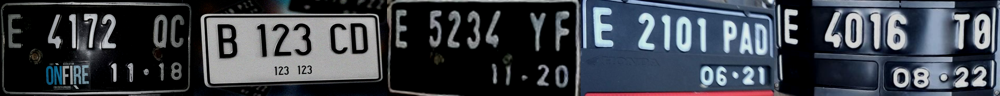

In [20]:
brightness_img1 = brightness(resolution_img1, -40)
brightness_img2 = brightness(resolution_img2, -60)
brightness_img3 = brightness(resolution_img3, -40)
brightness_img4 = brightness(resolution_img4, -20)
brightness_img5 = brightness(resolution_img5, -40)

final_frame = np.hstack((brightness_img1, brightness_img2, brightness_img3, brightness_img4, brightness_img5))

cv2_imshow(final_frame)

Saturation

In [11]:

def saturation(img, saturation_factor):
  result = cv.convertScaleAbs(img, alpha=1, beta=(1 - saturation_factor) * 255)
  return result


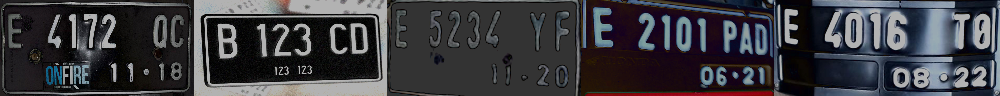

In [19]:


saturated_img1 = saturation(brightness_img1, 1.3)
saturated_img2 = saturation(brightness_img2, 1.7)
saturated_img3 = saturation(brightness_img3, 1.2)
saturated_img4 = saturation(brightness_img4, 1.3)
saturated_img5 = saturation(brightness_img5, 1.3)

final_frame = np.hstack((saturated_img1, saturated_img2, saturated_img3, saturated_img4, saturated_img5))

cv2_imshow(final_frame)



filter Gambar


In [21]:
def gaussian(img, n_kernel = 5):

  # Terapkan filter Gaussian
  gambar_filtered = cv.GaussianBlur(img, (n_kernel, n_kernel), 0)

  return gambar_filtered

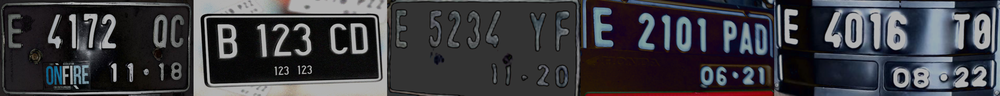

In [22]:


filtered_img1 = gaussian(saturated_img1, 3)
filtered_img2 = gaussian(saturated_img2, 3)
filtered_img3 = gaussian(saturated_img3, 1)
filtered_img4 = gaussian(saturated_img4, 3)
filtered_img5 = gaussian(saturated_img5, 3)

final_frame = np.hstack((filtered_img1, filtered_img2, filtered_img3, filtered_img4, filtered_img5))

cv2_imshow(final_frame)

# me2 = gaussian(me, 3)
# cv2_imshow(me2)



histogram equalization

In [23]:
def equalization(img):
  R, G, B = cv.split(img)

  # Lakukan histogram equalization pada setiap saluran
  R_equalized = cv.equalizeHist(R)
  G_equalized = cv.equalizeHist(G)
  B_equalized = cv.equalizeHist(B)

  # Gabungkan kembali saluran-saluran yang sudah diubah
  gambar_equalized = cv.merge((R_equalized, G_equalized, B_equalized))
  return gambar_equalized

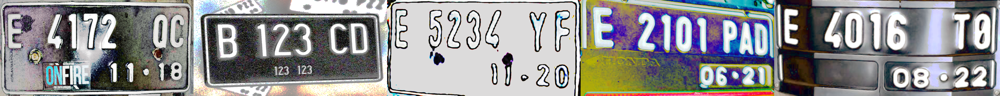

In [24]:
equalized_img1 = equalization(filtered_img1)
equalized_img2 = equalization(filtered_img2)
equalized_img3 = equalization(filtered_img3)
equalized_img4 = equalization(filtered_img4)
equalized_img5 = equalization(filtered_img5)

final_frame = np.hstack((equalized_img1, equalized_img2, equalized_img3, equalized_img4, equalized_img5))

cv2_imshow(final_frame)

# me7 = equalization(me2)
# cv2_imshow(me7)

Color Correction

In [25]:
def colorCorrection(img, n):
  result = np.zeros(img.shape, img.dtype)

  for y in range(img.shape[0]):
    for x in range(img.shape[1]):
      for c in range(img.shape[2]):
        if(img[y, x, c] > n):
          result[y, x, c] = img[y, x, c]
        else:
          result[y, x, c] = 0
  return result

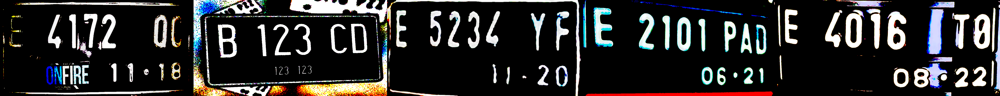

In [26]:
correction_img1 = colorCorrection(equalized_img1, 220)
correction_img2 = colorCorrection(equalized_img2, 220)
correction_img3 = colorCorrection(equalized_img3, 220)
correction_img4 = colorCorrection(equalized_img4, 220)
correction_img5 = colorCorrection(equalized_img5, 200)

final_frame = np.hstack((correction_img1, correction_img2, correction_img3, correction_img4, correction_img5))

cv2_imshow(final_frame)

KMeans

In [27]:
from sklearn.cluster import KMeans

def kmeans(img):
  # Ubah gambar menjadi array satu dimensi
  pixel_values = img.reshape((-1, 3))

  # Tentukan jumlah cluster (dalam hal ini, 2 warna)
  jumlah_cluster = 2

  # Inisialisasi model K-Means
  kmeans = KMeans(n_clusters=jumlah_cluster)

  # Lakukan kmeans clustering
  kmeans.fit(pixel_values)

  # Cek Nilai SSE
  print(f'Nilai SSE: {kmeans.inertia_}')

  # Dapatkan label cluster untuk setiap pixel
  labels = kmeans.labels_

  # Dapatkan titik tengah (warna rata-rata) dari masing-masing cluster
  colors = kmeans.cluster_centers_.astype(int)

  # Ubah img menjadi img hasil ekstraksi warna
  hasil_ekstraksi = colors[labels].reshape(img.shape)

  return hasil_ekstraksi

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Nilai SSE: 846922350.3126252


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Nilai SSE: 3426583360.021283


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Nilai SSE: 364315160.7798419


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Nilai SSE: 2635313541.5426607


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Nilai SSE: 1338956893.7365937


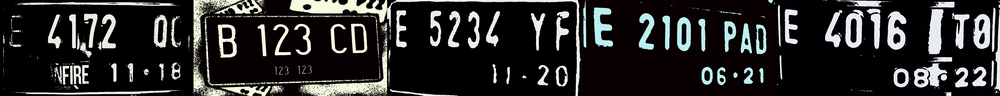

In [28]:
result_img1 = kmeans(correction_img1)
result_img2 = kmeans(correction_img2)
result_img3 = kmeans(correction_img3)
result_img4 = kmeans(correction_img4)
result_img5 = kmeans(correction_img5)

final_frame = np.hstack((result_img1, result_img2, result_img3, result_img4, result_img5))

cv2_imshow(final_frame)

# test3 = kmeans(test2)
# cv2_imshow(test3)

In [29]:


# Install pytesseract and Tesseract in Colab
!pip install pytesseract
!apt-get install tesseract-ocr
!apt-get install libtesseract-dev



Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 18 not upgraded.
Need to get 4,816 kB of archives.
After this operation, 15.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-osd all 1:4.00~git30-7274cfa-1.1 [2,990 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr amd64 4.1.1-2.1build1 [236 kB]
Fetched 4,816 kB in 1s (5,482 kB/s)
Selecting previously unselected package tesseract-ocr-eng.
(Reading database ... 120874 files and directories currently installed.)
Preparing to unpack .../tesseract-ocr-

In [33]:


import pytesseract

def recognize(img):
  # Perform OCR to recognize characters
  recognized_text = pytesseract.image_to_string(img, lang='eng')

  # Ground truth license plate characters
  ground_truth = 'E 5234 YF'  # Replace with actual ground truth

  # Calculate character recognition accuracy
  correct_characters = 0
  for gt_char, rec_char in zip(ground_truth, recognized_text):
      if gt_char == rec_char:
          correct_characters += 1

  total_characters = len(ground_truth)
  accuracy = correct_characters / total_characters * 100.0

  print(f'Ground Truth: {ground_truth}')
  print(f'Recognized Text: {recognized_text}')
  print(f'Character Recognition Accuracy: {accuracy:.2f}%')



Ground Truth: E 5234 YF
Recognized Text: lace eee ae

ae ee Dear tenlatcraerreerelrensstiionns, eaieleiiaaiiaaan

DPnps en

cma cen irr ene A

Character Recognition Accuracy: 0.00%


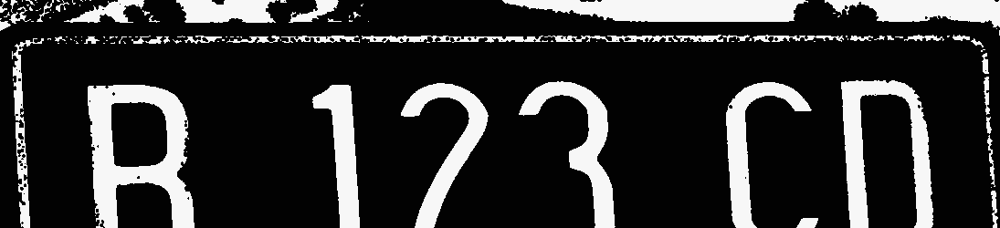

In [34]:
test = cv.convertScaleAbs(result_img2)
test = cv.cvtColor(test, cv.COLOR_BGR2GRAY)
# plt.imshow(test)

cropped_image = test[60:310, 55:1150]
recognize(cropped_image)
# plt.imshow(test)
cv2_imshow(cropped_image)